1. Import warnings and all the required libraries

In [1]:
import warnings
warnings.filterwarnings('ignore')

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as exp

1. Loading the data

In [2]:
#reading the application_data.csv file
newappldata = pd.read_csv('application_data.csv')

#reading the previous_application.csv file
prevappldata = pd.read_csv('previous_application.csv')

3. Inspecting the newappldata DataFrame- application_data.csv

In [3]:
# Displaying the first 5 rows of the DataFrame
newappldata.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
3,100006,0,Cash loans,F,N,Y,0,135000.0,312682.5,29686.5,...,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
4,100007,0,Cash loans,M,N,Y,0,121500.0,513000.0,21865.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0


In [4]:
#checking the dimension of the DataFrame
newappldata.shape

(307511, 122)

In [5]:
#displaying the data types and null counts of the DataFrame
newappldata.info(verbose=True, null_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 307511 entries, 0 to 307510
Data columns (total 122 columns):
 #   Column                        Non-Null Count   Dtype  
---  ------                        --------------   -----  
 0   SK_ID_CURR                    307511 non-null  int64  
 1   TARGET                        307511 non-null  int64  
 2   NAME_CONTRACT_TYPE            307511 non-null  object 
 3   CODE_GENDER                   307511 non-null  object 
 4   FLAG_OWN_CAR                  307511 non-null  object 
 5   FLAG_OWN_REALTY               307511 non-null  object 
 6   CNT_CHILDREN                  307511 non-null  int64  
 7   AMT_INCOME_TOTAL              307511 non-null  float64
 8   AMT_CREDIT                    307511 non-null  float64
 9   AMT_ANNUITY                   307499 non-null  float64
 10  AMT_GOODS_PRICE               307233 non-null  float64
 11  NAME_TYPE_SUITE               306219 non-null  object 
 12  NAME_INCOME_TYPE              307511 non-nu

In [6]:
# checking the summary for numeric columns
newappldata.describe()

,SK_ID_CURR,TARGET,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
count,307511.000000,307511.000000,307511.000000,3.075110e+05,3.075110e+05,307499.000000,3.072330e+05,307511.000000,307511.000000,307511.000000,...,307511.000000,307511.000000,307511.000000,307511.000000,265992.000000,265992.000000,265992.000000,265992.000000,265992.000000,265992.000000
mean,278180.518577,0.080729,0.417052,1.687979e+05,5.990260e+05,27108.573909,5.383962e+05,0.020868,-16036.995067,63815.045904,...,0.008130,0.000595,0.000507,0.000335,0.006402,0.007000,0.034362,0.267395,0.265474,1.899974
std,102790.175348,0.272419,0.722121,2.371231e+05,4.024908e+05,14493.737315,3.694465e+05,0.013831,4363.988632,141275.766519,...,0.089798,0.024387,0.022518,0.018299,0.083849,0.110757,0.204685,0.916002,0.794056,1.869295
min,100002.000000,0.000000,0.000000,2.565000e+04,4.500000e+04,1615.500000,4.050000e+04,0.000290,-25229.000000,-17912.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,189145.500000,0.000000,0.000000,1.125000e+05,2.700000e+05,16524.000000,2.385000e+05,0.010006,-19682.000000,-2760.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,278202.000000,0.000000,0.000000,1.471500e+05,5.135310e+05,24903.000000,4.500000e+05,0.018850,-15750.000000,-1213.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
75%,367142.500000,0.000000,1.000000,2.025000e+05,8.086500e+05,34596.000000,6.795000e+05,0.028663,-12413.000000,-289.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.000000
max,456255.000000,1.000000,19.000000,1.170000e+08,4.050000e+06,258025.500000,4.050000e+06,0.072508,-7489.000000,365243.000000,...,1.000000,1.000000,1.000000,1.000000,4.000000,9.000000,8.000000,27.000000,261.000000,25.000000


4. Data Cleaning for newappldata DataFrame- application_data.csv

In [7]:
# Checking the percentage of null values in each column
null_counts = newappldata.isnull().sum()/len(newappldata)*100

In [8]:
# Displaying the null_counts
null_counts.sort_values(ascending=False).head(60)

COMMONAREA_MEDI                 69.872297
COMMONAREA_AVG                  69.872297
COMMONAREA_MODE                 69.872297
NONLIVINGAPARTMENTS_MODE        69.432963
NONLIVINGAPARTMENTS_MEDI        69.432963
NONLIVINGAPARTMENTS_AVG         69.432963
FONDKAPREMONT_MODE              68.386172
LIVINGAPARTMENTS_MEDI           68.354953
LIVINGAPARTMENTS_MODE           68.354953
LIVINGAPARTMENTS_AVG            68.354953
FLOORSMIN_MEDI                  67.848630
FLOORSMIN_MODE                  67.848630
FLOORSMIN_AVG                   67.848630
YEARS_BUILD_MEDI                66.497784
YEARS_BUILD_AVG                 66.497784
YEARS_BUILD_MODE                66.497784
OWN_CAR_AGE                     65.990810
LANDAREA_MODE                   59.376738
LANDAREA_AVG                    59.376738
LANDAREA_MEDI                   59.376738
BASEMENTAREA_MEDI               58.515956
BASEMENTAREA_AVG                58.515956
BASEMENTAREA_MODE               58.515956
EXT_SOURCE_1                    56

In [9]:
# List of columns containing percentage of null values greater than 35%
null_val = newappldata.isnull().sum().sort_values(ascending=False)
null_val = null_val[null_val.values>(0.35*len(newappldata))]
null_val

#number of columns containing null values>35% 
len(null_val)

49

In [10]:
del_col = (newappldata.isnull().sum()/len(newappldata))
del_col = list(del_col[del_col.values>=0.35].index)
# del_col
newappldata.drop(labels=del_col, axis=1, inplace=True)
# len(del_col)


In [11]:
# dimension of dataset after deleting the columns containing null values>35%
newappldata.shape

(307511, 73)

In [12]:
# Checking the % of null values in each column 
null1 = newappldata.isnull().sum()/len(newappldata)*100
null1.sort_values(ascending=True).head(60)

SK_ID_CURR                     0.000000
HOUR_APPR_PROCESS_START        0.000000
REG_REGION_NOT_LIVE_REGION     0.000000
REG_REGION_NOT_WORK_REGION     0.000000
LIVE_REGION_NOT_WORK_REGION    0.000000
REG_CITY_NOT_WORK_CITY         0.000000
LIVE_CITY_NOT_WORK_CITY        0.000000
ORGANIZATION_TYPE              0.000000
FLAG_DOCUMENT_2                0.000000
FLAG_DOCUMENT_3                0.000000
FLAG_DOCUMENT_4                0.000000
FLAG_DOCUMENT_5                0.000000
FLAG_DOCUMENT_6                0.000000
FLAG_DOCUMENT_7                0.000000
FLAG_DOCUMENT_8                0.000000
FLAG_DOCUMENT_9                0.000000
FLAG_DOCUMENT_10               0.000000
FLAG_DOCUMENT_11               0.000000
FLAG_DOCUMENT_12               0.000000
FLAG_DOCUMENT_13               0.000000
FLAG_DOCUMENT_14               0.000000
FLAG_DOCUMENT_15               0.000000
FLAG_DOCUMENT_16               0.000000
FLAG_DOCUMENT_17               0.000000
FLAG_DOCUMENT_18               0.000000


5. Imputing missing values in some columns

In [13]:
#imputing the missing values for column OCCUPATION_TYPE with mode
# newappldata.OCCUPATION_TYPE.isnull().sum()/len(newappldata)*100
newappldata.OCCUPATION_TYPE.value_counts()

Laborers                 55186
Sales staff              32102
Core staff               27570
Managers                 21371
Drivers                  18603
High skill tech staff    11380
Accountants               9813
Medicine staff            8537
Security staff            6721
Cooking staff             5946
Cleaning staff            4653
Private service staff     2652
Low-skill Laborers        2093
Waiters/barmen staff      1348
Secretaries               1305
Realty agents              751
HR staff                   563
IT staff                   526
Name: OCCUPATION_TYPE, dtype: int64

In [14]:
newappldata.OCCUPATION_TYPE.mode()


0    Laborers
dtype: object

In [15]:
newappldata['OCCUPATION_TYPE'] = newappldata['OCCUPATION_TYPE'].fillna(newappldata['OCCUPATION_TYPE'].mode()[0]) 
newappldata.OCCUPATION_TYPE.isnull().sum()/len(newappldata)*100
# newappldata.OCCUPATION_TYPE.head(60)

0.0

In [16]:
#imputing the missing values for column AMT_REQ_CREDIT_BUREAU_YEAR with mode
# newappldata.AMT_REQ_CREDIT_BUREAU_YEAR.isnull().sum()/len(newappldata)*100
newappldata.AMT_REQ_CREDIT_BUREAU_YEAR.value_counts()

0.0     71801
1.0     63405
2.0     50192
3.0     33628
4.0     20714
5.0     12052
6.0      6967
7.0      3869
8.0      2127
9.0      1096
11.0       31
12.0       30
10.0       22
13.0       19
14.0       10
17.0        7
15.0        6
19.0        4
18.0        4
16.0        3
21.0        1
23.0        1
25.0        1
20.0        1
22.0        1
Name: AMT_REQ_CREDIT_BUREAU_YEAR, dtype: int64

In [17]:
newappldata.AMT_REQ_CREDIT_BUREAU_YEAR.mode()

0    0.0
dtype: float64

In [18]:
newappldata['AMT_REQ_CREDIT_BUREAU_YEAR'] = newappldata['AMT_REQ_CREDIT_BUREAU_YEAR'].fillna(newappldata['AMT_REQ_CREDIT_BUREAU_YEAR'].mode()[0]) 
newappldata.AMT_REQ_CREDIT_BUREAU_YEAR.isnull().sum()/len(newappldata)*100
# newappldata.AMT_REQ_CREDIT_BUREAU_YEAR.head(60)

0.0

In [19]:
#AMT_REQ_CREDIT_BUREAU_QRT       
# AMT_REQ_CREDIT_BUREAU_YEAR      
# AMT_REQ_CREDIT_BUREAU_WEEK      
# AMT_REQ_CREDIT_BUREAU_MON       
# AMT_REQ_CREDIT_BUREAU_DAY       
# AMT_REQ_CREDIT_BUREAU_HOUR 
# Since all these columns contain number of credit entries, replacing the missing values with most frequent value(mode) makes more sense.
newappldata.AMT_REQ_CREDIT_BUREAU_WEEK.mode()

0    0.0
dtype: float64

In [20]:
newappldata['AMT_REQ_CREDIT_BUREAU_WEEK'] = newappldata['AMT_REQ_CREDIT_BUREAU_WEEK'].fillna(newappldata['AMT_REQ_CREDIT_BUREAU_WEEK'].mode()[0]) 
newappldata.AMT_REQ_CREDIT_BUREAU_WEEK.isnull().sum()/len(newappldata)*100
# newappldata.AMT_REQ_CREDIT_BUREAU_WEEK.head(60)

0.0

In [21]:
newappldata.AMT_REQ_CREDIT_BUREAU_QRT.mode()

0    0.0
dtype: float64

In [22]:
newappldata['AMT_REQ_CREDIT_BUREAU_QRT'] = newappldata['AMT_REQ_CREDIT_BUREAU_QRT'].fillna(newappldata['AMT_REQ_CREDIT_BUREAU_QRT'].mode()[0]) 
newappldata.AMT_REQ_CREDIT_BUREAU_QRT.isnull().sum()/len(newappldata)*100
# newappldata.AMT_REQ_CREDIT_BUREAU_QRT.head(60)

0.0

In [23]:
newappldata.AMT_REQ_CREDIT_BUREAU_MON.mode()

0    0.0
dtype: float64

In [24]:
newappldata['AMT_REQ_CREDIT_BUREAU_MON'] = newappldata['AMT_REQ_CREDIT_BUREAU_MON'].fillna(newappldata['AMT_REQ_CREDIT_BUREAU_MON'].mode()[0]) 
newappldata.AMT_REQ_CREDIT_BUREAU_MON.isnull().sum()/len(newappldata)*100
# newappldata.AMT_REQ_CREDIT_BUREAU_MON.head(60)

0.0

In [25]:
newappldata.AMT_REQ_CREDIT_BUREAU_HOUR.mode()

0    0.0
dtype: float64

In [26]:
newappldata['AMT_REQ_CREDIT_BUREAU_HOUR'] = newappldata['AMT_REQ_CREDIT_BUREAU_HOUR'].fillna(newappldata['AMT_REQ_CREDIT_BUREAU_HOUR'].mode()[0]) 
newappldata.AMT_REQ_CREDIT_BUREAU_HOUR.isnull().sum()/len(newappldata)*100
# newappldata.AMT_REQ_CREDIT_BUREAU_HOUR.head(60)

0.0

In [27]:
newappldata.AMT_REQ_CREDIT_BUREAU_DAY.mode()

0    0.0
dtype: float64

In [28]:
newappldata['AMT_REQ_CREDIT_BUREAU_DAY'] = newappldata['AMT_REQ_CREDIT_BUREAU_DAY'].fillna(newappldata['AMT_REQ_CREDIT_BUREAU_DAY'].mode()[0]) 
newappldata.AMT_REQ_CREDIT_BUREAU_DAY.isnull().sum()/len(newappldata)*100
# newappldata.AMT_REQ_CREDIT_BUREAU_DAY.head(60)

0.0

In [29]:
# imputing missing values of AMT_GOODS_PRICE with the median
# newappldata.AMT_GOODS_PRICE.isnull().sum()/len(newappldata)*100
newappldata.AMT_GOODS_PRICE.value_counts()

450000.0    26022
225000.0    25282
675000.0    24962
900000.0    15416
270000.0    11428
            ...  
705892.5        1
442062.0        1
353641.5        1
353749.5        1
738945.0        1
Name: AMT_GOODS_PRICE, Length: 1002, dtype: int64

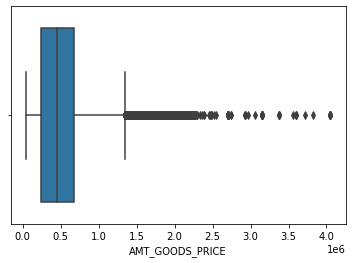

In [30]:
# Checking for outliers
sns.boxplot(newappldata['AMT_GOODS_PRICE'])
plt.show()

In [31]:
#better to use median due to presence of outliers
newappldata.AMT_GOODS_PRICE.median()

450000.0

In [32]:
#imputing missing values with median
newappldata['AMT_GOODS_PRICE'] = newappldata['AMT_GOODS_PRICE'].fillna(newappldata['AMT_GOODS_PRICE'].median())
newappldata.AMT_GOODS_PRICE.isnull().sum()/len(newappldata)*100

0.0

In [33]:
# imputing missing values of AMT_ANNUITY with the median  
# newappldata.AMT_ANNUITY.isnull().sum()/len(newappldata)*100
newappldata.AMT_ANNUITY.value_counts()

9000.0     6385
13500.0    5514
6750.0     2279
10125.0    2035
37800.0    1602
           ... 
15210.0       1
50265.0       1
73012.5       1
40558.5       1
4437.0        1
Name: AMT_ANNUITY, Length: 13672, dtype: int64

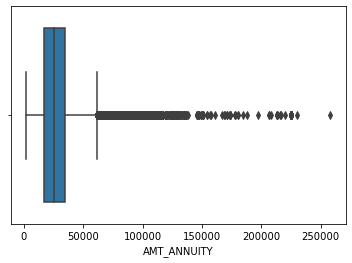

In [34]:
# Since AMT_ANNUITY is a continuous variable. Hence, it is better to check for outliers.
sns.boxplot(newappldata['AMT_ANNUITY'])
plt.show()

In [35]:
#better to use median due to presence of outliers
newappldata.AMT_ANNUITY.median()

24903.0

In [36]:
#imputing missing values with median
newappldata['AMT_ANNUITY'] = newappldata['AMT_ANNUITY'].fillna(newappldata['AMT_ANNUITY'].median())
newappldata.AMT_ANNUITY.isnull().sum()/len(newappldata)*100

0.0

6. Checking errors in data types and data

In [37]:
newappldata.dtypes

#Checking the float type columns
newappldata.select_dtypes(include='float64').columns

Index(['AMT_INCOME_TOTAL', 'AMT_CREDIT', 'AMT_ANNUITY', 'AMT_GOODS_PRICE',
       'REGION_POPULATION_RELATIVE', 'DAYS_REGISTRATION', 'CNT_FAM_MEMBERS',
       'EXT_SOURCE_2', 'EXT_SOURCE_3', 'OBS_30_CNT_SOCIAL_CIRCLE',
       'DEF_30_CNT_SOCIAL_CIRCLE', 'OBS_60_CNT_SOCIAL_CIRCLE',
       'DEF_60_CNT_SOCIAL_CIRCLE', 'DAYS_LAST_PHONE_CHANGE',
       'AMT_REQ_CREDIT_BUREAU_HOUR', 'AMT_REQ_CREDIT_BUREAU_DAY',
       'AMT_REQ_CREDIT_BUREAU_WEEK', 'AMT_REQ_CREDIT_BUREAU_MON',
       'AMT_REQ_CREDIT_BUREAU_QRT', 'AMT_REQ_CREDIT_BUREAU_YEAR'],
      dtype='object')

In [38]:
# Converting these count columns to int64
conv_col = ['OBS_30_CNT_SOCIAL_CIRCLE','DEF_30_CNT_SOCIAL_CIRCLE', 'OBS_60_CNT_SOCIAL_CIRCLE',
                       'DEF_60_CNT_SOCIAL_CIRCLE', 'DAYS_LAST_PHONE_CHANGE','AMT_REQ_CREDIT_BUREAU_HOUR', 
                       'AMT_REQ_CREDIT_BUREAU_DAY','AMT_REQ_CREDIT_BUREAU_WEEK', 'AMT_REQ_CREDIT_BUREAU_MON',
                       'AMT_REQ_CREDIT_BUREAU_QRT', 'AMT_REQ_CREDIT_BUREAU_YEAR']
newappldata.loc[:,conv_col]= newappldata.loc[:,conv_col].apply(lambda col: col.astype('int', errors='ignore'))


In [39]:
# Checking the object type columns
conv_col = list(newappldata.select_dtypes(include='object').columns)
conv_col

['NAME_CONTRACT_TYPE',
 'CODE_GENDER',
 'FLAG_OWN_CAR',
 'FLAG_OWN_REALTY',
 'NAME_TYPE_SUITE',
 'NAME_INCOME_TYPE',
 'NAME_EDUCATION_TYPE',
 'NAME_FAMILY_STATUS',
 'NAME_HOUSING_TYPE',
 'OCCUPATION_TYPE',
 'WEEKDAY_APPR_PROCESS_START',
 'ORGANIZATION_TYPE']

In [40]:
# Converting those object type into str
newappldata.loc[:, conv_col] = newappldata.loc[:, conv_col].apply(lambda col: col.astype('str', errors='ignore'))

In [41]:
# Checking the data after doing the above changes
newappldata.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,...,0,0,0,0,0,0,0,0,0,1
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,...,0,0,0,0,0,0,0,0,0,0
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,...,0,0,0,0,0,0,0,0,0,0
3,100006,0,Cash loans,F,N,Y,0,135000.0,312682.5,29686.5,...,0,0,0,0,0,0,0,0,0,0
4,100007,0,Cash loans,M,N,Y,0,121500.0,513000.0,21865.5,...,0,0,0,0,0,0,0,0,0,0


In [42]:
# Making Gender column more readable
newappldata['CODE_GENDER'].value_counts()

F      202448
M      105059
XNA         4
Name: CODE_GENDER, dtype: int64

In [43]:
# Replacing XNA- not available for the column 'CODE_GENDER'
newappldata.loc[newappldata.CODE_GENDER == 'XNA', 'CODE_GENDER']= 'F'
newappldata.CODE_GENDER.value_counts()

F    202452
M    105059
Name: CODE_GENDER, dtype: int64

In [44]:
#Making ORGANIZATION_TYPE more readable
newappldata.ORGANIZATION_TYPE.value_counts()

Business Entity Type 3    67992
XNA                       55374
Self-employed             38412
Other                     16683
Medicine                  11193
Business Entity Type 2    10553
Government                10404
School                     8893
Trade: type 7              7831
Kindergarten               6880
Construction               6721
Business Entity Type 1     5984
Transport: type 4          5398
Trade: type 3              3492
Industry: type 9           3368
Industry: type 3           3278
Security                   3247
Housing                    2958
Industry: type 11          2704
Military                   2634
Bank                       2507
Agriculture                2454
Police                     2341
Transport: type 2          2204
Postal                     2157
Security Ministries        1974
Trade: type 2              1900
Restaurant                 1811
Services                   1575
University                 1327
Industry: type 7           1307
Transpor

In [45]:
# Replacing XNA with NaN
newappldata = newappldata.replace('XNA', np.NaN)

In [46]:
newappldata.ORGANIZATION_TYPE.value_counts()

Business Entity Type 3    67992
Self-employed             38412
Other                     16683
Medicine                  11193
Business Entity Type 2    10553
Government                10404
School                     8893
Trade: type 7              7831
Kindergarten               6880
Construction               6721
Business Entity Type 1     5984
Transport: type 4          5398
Trade: type 3              3492
Industry: type 9           3368
Industry: type 3           3278
Security                   3247
Housing                    2958
Industry: type 11          2704
Military                   2634
Bank                       2507
Agriculture                2454
Police                     2341
Transport: type 2          2204
Postal                     2157
Security Ministries        1974
Trade: type 2              1900
Restaurant                 1811
Services                   1575
University                 1327
Industry: type 7           1307
Transport: type 3          1187
Industry

In [47]:
# Checking the values present in columns starting with 'DAYS'
print(newappldata.DAYS_BIRTH.unique())
print(newappldata.DAYS_EMPLOYED.unique())
print(newappldata.DAYS_ID_PUBLISH.unique())
print(newappldata.DAYS_LAST_PHONE_CHANGE.unique())
print(newappldata.DAYS_REGISTRATION.unique())

[ -9461 -16765 -19046 ...  -7951  -7857 -25061]
[  -637  -1188   -225 ... -12971 -11084  -8694]
[-2120  -291 -2531 ... -6194 -5854 -6211]
[-1134.  -828.  -815. ... -3988. -3899. -3538.]
[ -3648.  -1186.  -4260. ... -16396. -14558. -14798.]


In [48]:
new_col = [cl for cl in newappldata if cl.startswith('DAYS')]
new_col

['DAYS_BIRTH',
 'DAYS_EMPLOYED',
 'DAYS_REGISTRATION',
 'DAYS_ID_PUBLISH',
 'DAYS_LAST_PHONE_CHANGE']

In [49]:
# Applying abs function to convert the negative values to positive
newappldata[new_col] = abs(newappldata[new_col])

# Checking the above changes
print(newappldata.DAYS_BIRTH.unique())
print(newappldata.DAYS_EMPLOYED.unique())
print(newappldata.DAYS_ID_PUBLISH.unique())
print(newappldata.DAYS_LAST_PHONE_CHANGE.unique())
print(newappldata.DAYS_REGISTRATION.unique())

[ 9461. 16765. 19046. ...  7951.  7857. 25061.]
[  637.  1188.   225. ... 12971. 11084.  8694.]
[2120.  291. 2531. ... 6194. 5854. 6211.]
[1134.  828.  815. ... 3988. 3899. 3538.]
[ 3648.  1186.  4260. ... 16396. 14558. 14798.]


 7. Creating bins for countinuous varaible categories column- 'AMT_INCOME_TOTAL' and 'AMT_CREDIT'

In [50]:
# binning INCOME_GROUP based on quantiles
# newappldata.AMT_INCOME_TOTAL
newappldata['AMT_INCOME_TOTAL'].quantile([0,0.2,0.5,0.8,0.95,1])

0.00        25650.0
0.20        99000.0
0.50       147150.0
0.80       225000.0
0.95       337500.0
1.00    117000000.0
Name: AMT_INCOME_TOTAL, dtype: float64

In [51]:
# binning INCOME_GROUP based on quantiles
newappldata['INCOME_GROUP'] = pd.qcut(newappldata.AMT_INCOME_TOTAL, q=[0,0.2,0.5,0.8,0.95,1], labels=['VERY_LOW', 'LOW', 'MEDIUM', 'HIGH', 'VERY_HIGH'])
newappldata['INCOME_GROUP'].head(11)

0        MEDIUM
1          HIGH
2      VERY_LOW
3           LOW
4           LOW
5      VERY_LOW
6        MEDIUM
7     VERY_HIGH
8           LOW
9           LOW
10          LOW
Name: INCOME_GROUP, dtype: category
Categories (5, object): ['VERY_LOW' < 'LOW' < 'MEDIUM' < 'HIGH' < 'VERY_HIGH']

In [52]:
#binning AMT_CREDIT_RANGE by creating various ranges
newappldata['AMT_CREDIT_RANGE'] = pd.qcut(newappldata.AMT_CREDIT, q=[0,0.2,0.5,0.8,0.95,1], labels=['VERY_LOW', 'LOW', 'MEDIUM', 'HIGH', 'VERY_HIGH'])
newappldata['AMT_CREDIT_RANGE'].head(11)

0           LOW
1          HIGH
2      VERY_LOW
3           LOW
4           LOW
5           LOW
6     VERY_HIGH
7     VERY_HIGH
8          HIGH
9           LOW
10       MEDIUM
Name: AMT_CREDIT_RANGE, dtype: category
Categories (5, object): ['VERY_LOW' < 'LOW' < 'MEDIUM' < 'HIGH' < 'VERY_HIGH']

In [53]:
# Converting DAYS_BIRTH to years
newappldata['DAYS_BIRTH'] = (newappldata['DAYS_BIRTH']/365).astype(int)

In [54]:
newappldata.DAYS_BIRTH.unique()

array([25, 45, 52, 54, 46, 37, 51, 55, 39, 27, 36, 38, 23, 35, 26, 48, 31,
       50, 40, 30, 68, 43, 28, 41, 32, 33, 47, 57, 65, 44, 64, 21, 59, 49,
       56, 62, 53, 42, 29, 67, 63, 61, 58, 60, 34, 22, 24, 66, 69, 20])

In [55]:
newappldata.DAYS_BIRTH.describe()

count    307511.000000
mean         43.435968
std          11.954593
min          20.000000
25%          34.000000
50%          43.000000
75%          53.000000
max          69.000000
Name: DAYS_BIRTH, dtype: float64

In [56]:
#binning DAYS_BIRTH 
newappldata['DAYS_BIRTH_BINS']=pd.cut(newappldata.DAYS_BIRTH, bins=[19,25,35,60,100], labels=['very_young', 'young', 'middle_age', 'Seniour_citizen'])

In [57]:
newappldata.DAYS_BIRTH_BINS.value_counts()

middle_age         185900
young               75925
Seniour_citizen     29368
very_young          16318
Name: DAYS_BIRTH_BINS, dtype: int64

8. Finding Outliers

In [58]:
#boxplot to check 'AMT_INCOME_TOTAL' column to check outliers
# sns.boxplot(data=newappldata, y='AMT_INCOME_TOTAL')
# plt.title('Distribution of AMT_INCOME_TOTAL')
# plt.show()
outlier_check = exp.box(newappldata, y='AMT_INCOME_TOTAL', title='Distribution of AMT_INCOME_TOTAL')
outlier_check.show()

- this column tells the income of the client. We can see that 117M is an outlier in this case.

In [59]:
#distribution of 'AMT_ANNUITY' to check outliers
outlier_check = exp.box(newappldata, y='AMT_ANNUITY', title='Distribution of AMT_ANNUITY')
outlier_check.show()
# sns.boxplot(data=newappldata, y='AMT_ANNUITY')
# plt.title('Distribution of AMT_ANNUITY')
# plt.show()

- this column tells the loan annuity. We can see that 258.025k is an outlier in this case. 

9. Checking for imbalance in Target variable

In [60]:
newappldata.TARGET.value_counts(normalize=True)*100

0    91.927118
1     8.072882
Name: TARGET, dtype: float64

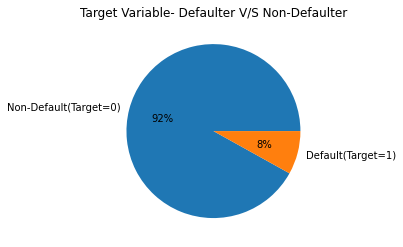

In [61]:
plt.pie(newappldata.TARGET.value_counts(normalize=True)*100, labels=['Non-Default(Target=0)','Default(Target=1)'], autopct='%1.f%%')
plt.title('Target Variable- Defaulter V/S Non-Defaulter')
plt.show()

It is clear that there is imbalance between people who defaulted and who didn't default. More than 90% of the people didn't default as opposed to 8% who defaulted.

10. Dividing the datasets into two different datasets based on 'Target' value

In [62]:
target_0 = newappldata.loc[newappldata['TARGET']== 0]
target_1 = newappldata.loc[newappldata['TARGET']== 1]

11. Univariate Analysis of Categorical variables

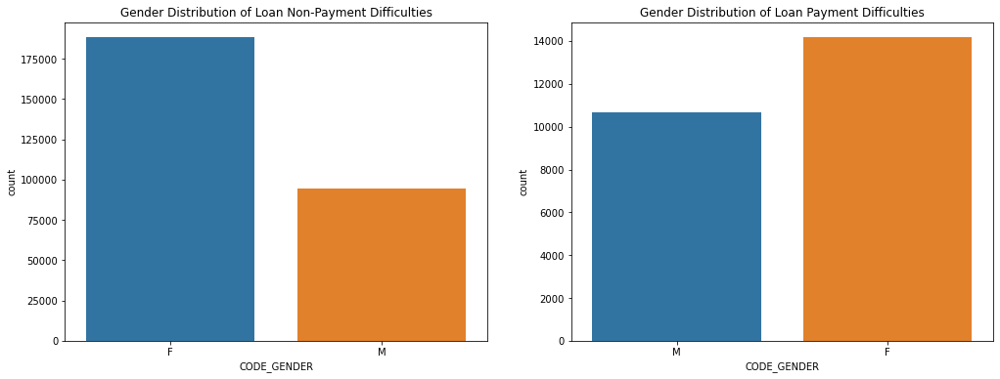

In [63]:
# Analysis based on gender distribution
plt.figure(figsize=(17,6))
plt.subplot(1,2,1)
sns.countplot(target_0['CODE_GENDER'])
plt.title('Gender Distribution of Loan Non-Payment Difficulties')
plt.subplot(1,2,2)
sns.countplot(target_1['CODE_GENDER'])
plt.title('Gender Distribution of Loan Payment Difficulties')
plt.show()

- Comparing the Payment Difficulties and Non Payment Difficulties based on the gender, we observe that Females are the majority in both the cases. 
- Also, there is an increase in Male Payment Difficulties from Non-Payment Difficulties.


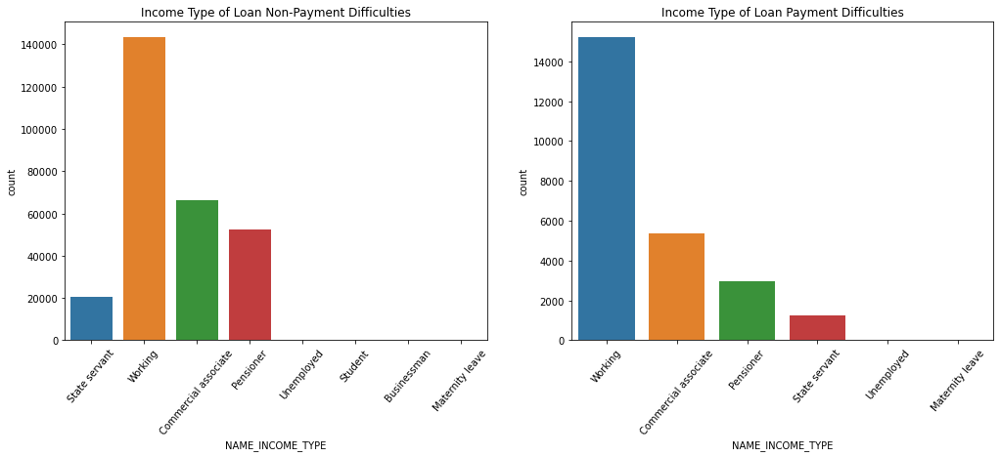

In [64]:
# Analysis based on income type
plt.figure(figsize=(17,6))
plt.subplot(1,2,1)
sns.countplot(target_0['NAME_INCOME_TYPE'])
plt.title('Income Type of Loan Non-Payment Difficulties')
plt.xticks(rotation=50)
plt.subplot(1,2,2)
sns.countplot(target_1['NAME_INCOME_TYPE'])
plt.title('Income Type of Loan Payment Difficulties')
plt.xticks(rotation=50)
plt.show()

- We can conclude that students don't default. They don't need to pay during the time they are students.
- We can also see that businessmen never default.
- Working class people has more loan payment difficulties as compared to non-payment difficulties/non-defaulters.

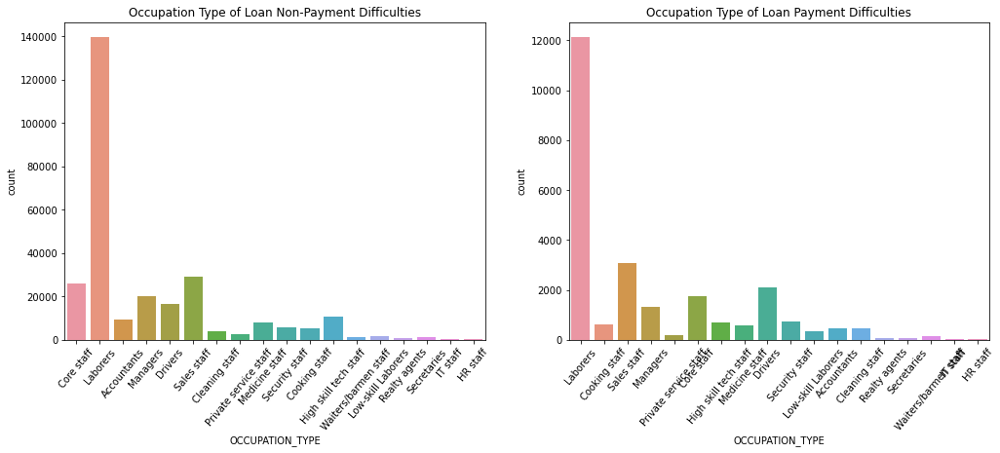

In [65]:
# Analysis based on type of occupation
plt.figure(figsize=(17,6))
plt.subplot(1,2,1)
sns.countplot(target_0['OCCUPATION_TYPE'])
plt.title('Occupation Type of Loan Non-Payment Difficulties')
plt.xticks(rotation=50)
plt.subplot(1,2,2)
sns.countplot(target_1['OCCUPATION_TYPE'])
plt.title('Occupation Type of Loan Payment Difficulties')
plt.xticks(rotation=50)
plt.show()


- We can see that labourers are the majority in both the cases. Also, labourers are more likely to pay the loan on time as compared to the loan payment difficulties. 
- HR Staff, IT staff, waiters are least likely to be part of loan payment process.

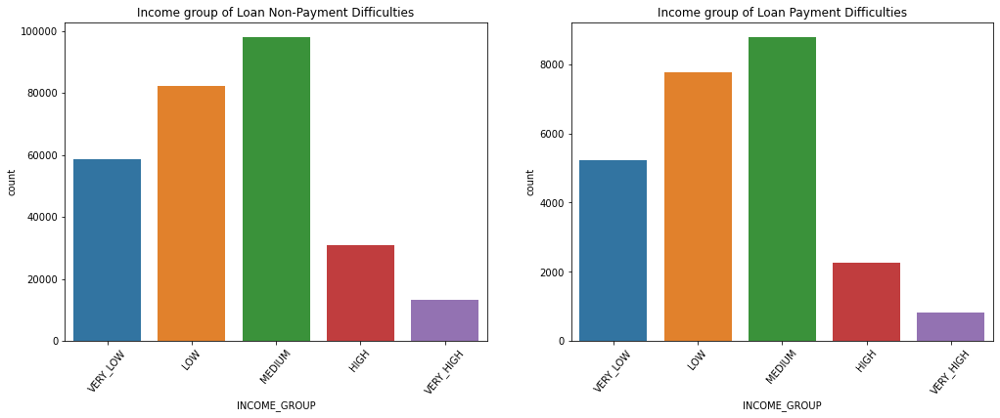

In [66]:
#Analysis based on income group
plt.figure(figsize=(17,6))
plt.subplot(1,2,1)
sns.countplot(target_0['INCOME_GROUP'])
plt.title('Income group of Loan Non-Payment Difficulties')
plt.xticks(rotation=50)
plt.subplot(1,2,2)
sns.countplot(target_1['INCOME_GROUP'])
plt.title('Income group of Loan Payment Difficulties')
plt.xticks(rotation=50)
plt.show()

- We observe an increase in the loan payment difficulties whose income is low when compared with the other income groups of payment difficulties and non-payment difficulties.

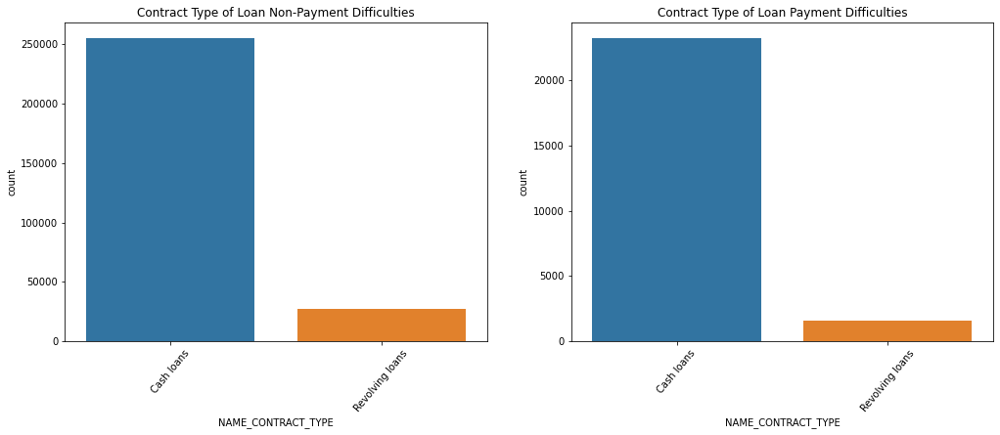

In [67]:
# Analysis based on contract type
plt.figure(figsize=(17,6))
plt.subplot(1,2,1)
sns.countplot(target_0['NAME_CONTRACT_TYPE'])
plt.title('Contract Type of Loan Non-Payment Difficulties')
plt.xticks(rotation=50)
plt.subplot(1,2,2)
sns.countplot(target_1['NAME_CONTRACT_TYPE'])
plt.title('Contract Type of Loan Payment Difficulties')
plt.xticks(rotation=50)
plt.show()

- We can observe that cash loans are preffered by both Loan Payment difficulties and Loan Non-Payment difficulties.
- Also, there is decrease in the loan payment difficulties in case of revolving loans.

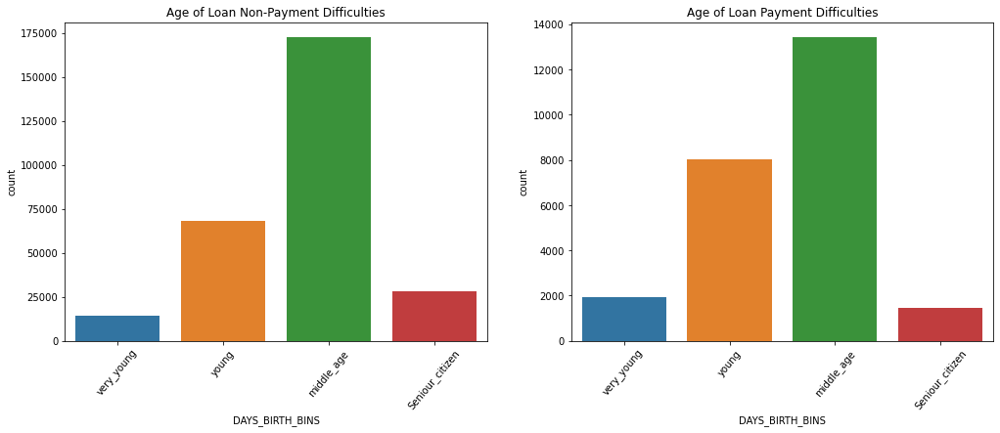

In [68]:
# Analysis based on age
plt.figure(figsize=(17,6))
plt.subplot(1,2,1)
sns.countplot(target_0['DAYS_BIRTH_BINS'])
plt.title('Age of Loan Non-Payment Difficulties')
plt.xticks(rotation=50)
plt.subplot(1,2,2)
sns.countplot(target_1['DAYS_BIRTH_BINS'])
plt.title('Age of Loan Payment Difficulties')
plt.xticks(rotation=50)
plt.show()

- We observe that there is increase in loan payment difficulties who are young in age when compared to other age groups in loan payment and non-payment difficulties.

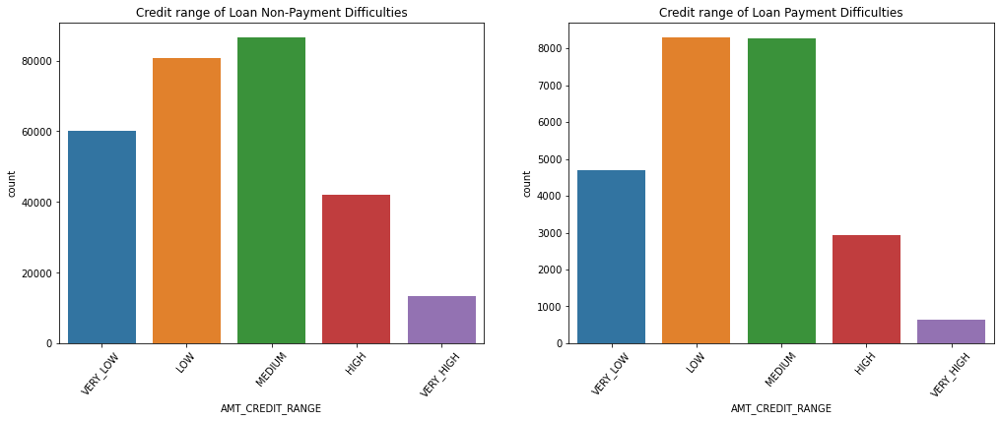

In [69]:
# Analysis based on credit range
plt.figure(figsize=(17,6))
plt.subplot(1,2,1)
sns.countplot(target_0['AMT_CREDIT_RANGE'])
plt.title('Credit range of Loan Non-Payment Difficulties')
plt.xticks(rotation=50)
plt.subplot(1,2,2)
sns.countplot(target_1['AMT_CREDIT_RANGE'])
plt.title('Credit range of Loan Payment Difficulties')
plt.xticks(rotation=50)
plt.show()

- We can observe that the low credit range has more loan payment difficulties when compared to the remaining credit ranges in loan payment and non-payment difficulties.

12. Univariate analysis of continuous numeric variables

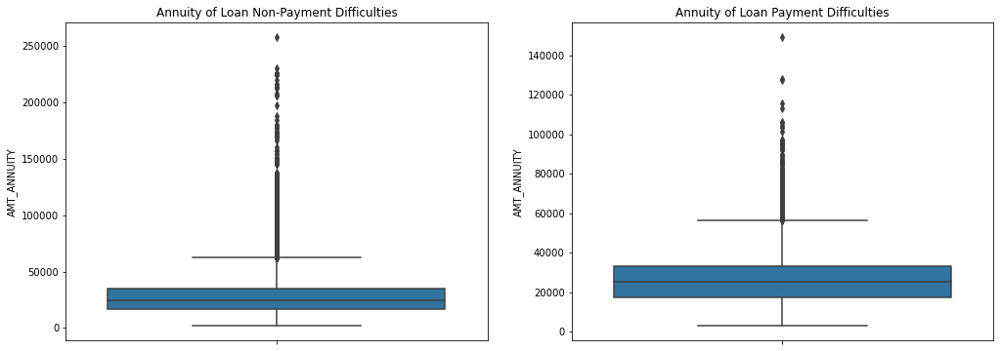

In [70]:
# box plot for 'AMT_ANNUITY'
plt.figure(figsize=(17,6))
plt.subplot(1,2,1)
sns.boxplot(data=target_0, y='AMT_ANNUITY')
plt.title('Annuity of Loan Non-Payment Difficulties')
plt.xticks(rotation=50)
plt.subplot(1,2,2)
sns.boxplot(data=target_1, y='AMT_ANNUITY')
plt.title('Annuity of Loan Payment Difficulties')
plt.xticks(rotation=50)
plt.show()

- We can observe some outliers and first quartile is bigger than third quartile in case of loan payment difficulties. This means that most of the annuity clients are from first quartile.

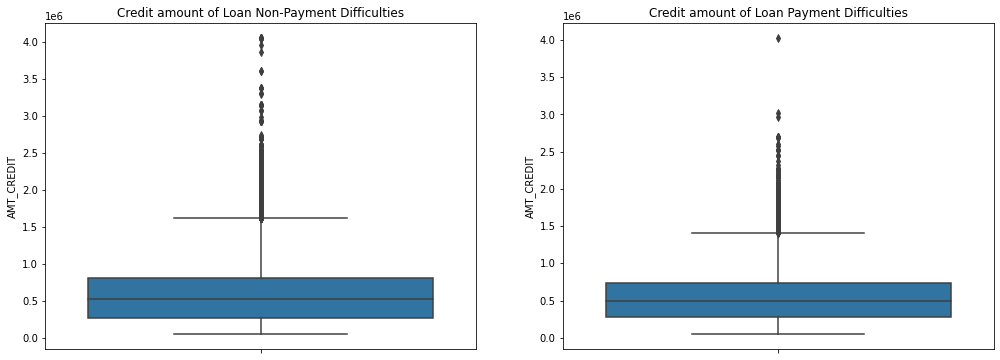

In [71]:
# Analysis based on credit amount
plt.figure(figsize=(17,6))
plt.subplot(1,2,1)
# target_0['AMT_CREDIT'].plot.hist()
sns.boxplot(data=target_0, y='AMT_CREDIT')
plt.title('Credit amount of Loan Non-Payment Difficulties')
plt.xticks(rotation=50)
plt.subplot(1,2,2)
# target_1['AMT_CREDIT'].plot.hist()
sns.boxplot(data=target_1, y='AMT_CREDIT')
plt.title('Credit amount of Loan Payment Difficulties')
plt.xticks(rotation=50)
plt.show()

- We can observe some outliers and first quartile is bigger than third quartile in case of loan payment difficulties. This means most of the credits of clients are present in first quartile.

13. Bivariate analysis 

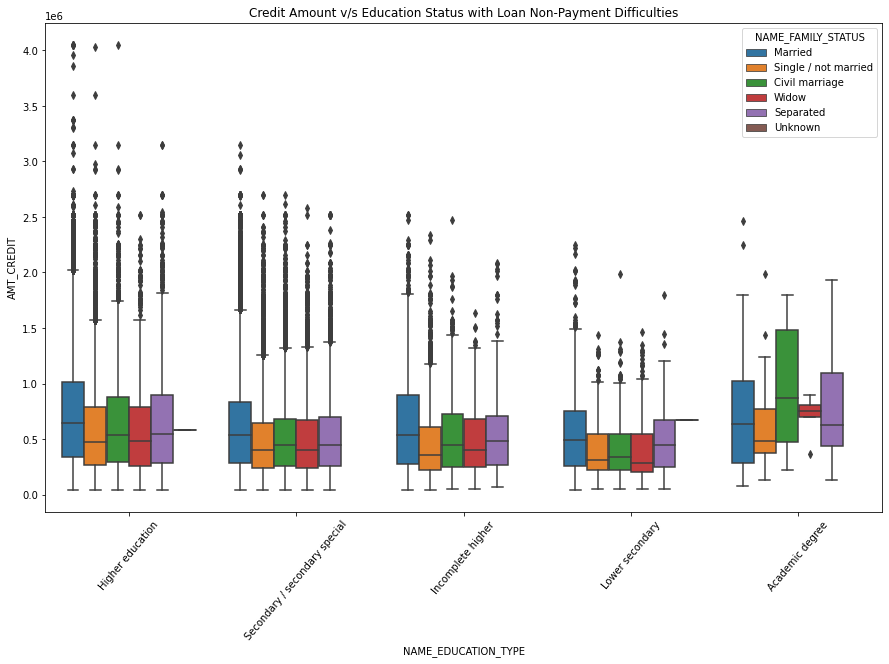

In [76]:
# For target_0
#Plotting for AMT_CREDIT_AMOUNT 
plt.figure(figsize=(15,9))
plt.xticks(rotation=50)
sns.boxplot(data=target_0, x='NAME_EDUCATION_TYPE', y='AMT_CREDIT', hue='NAME_FAMILY_STATUS', orient='v')
plt.title('Credit Amount v/s Education Status with Loan Non-Payment Difficulties')
plt.show()

- From the above box plot we can conclude that Family Status of 'Civil Marriage', 'Marriage' and 'Separated' of Academic degree education are having higher number of credits than others.
- Also, Higher education of family status 'marriage', 'single' and 'civil marriage' have more oultiers.
- 'Civil Marriage' in Academic Degree have most of the credits in the third quartile

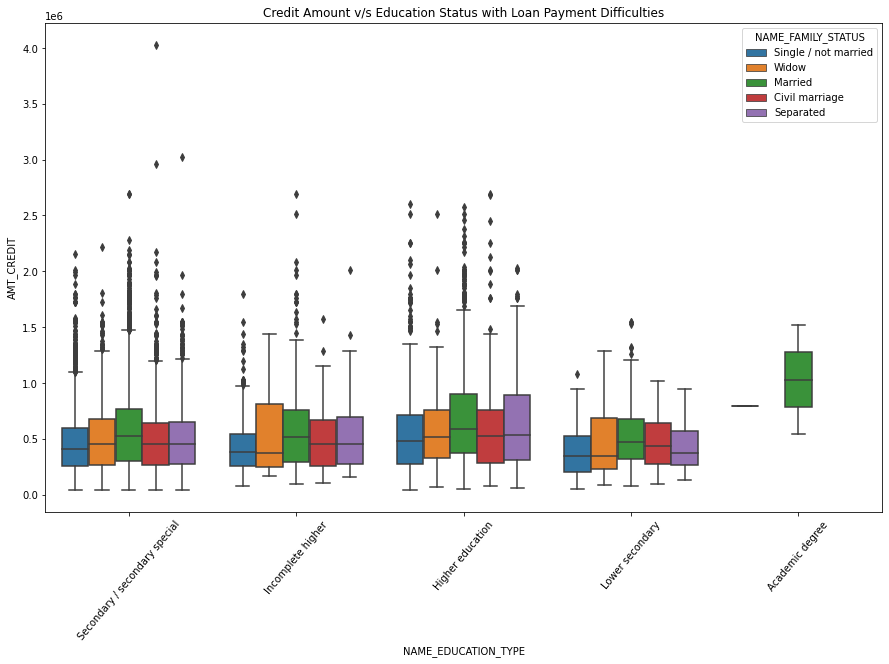

In [77]:
# For target_1
#Plotting for AMT_CREDIT_AMOUNT 
plt.figure(figsize=(15,9))
plt.xticks(rotation=50)
sns.boxplot(data=target_1, x='NAME_EDUCATION_TYPE', y='AMT_CREDIT', hue='NAME_FAMILY_STATUS', orient='v')
plt.title('Credit Amount v/s Education Status with Loan Payment Difficulties')
plt.show()

- From the above boxplot we can conclude that the family status of 'Marriage' of Academic Degree ducation have higher number of credits than others in case of loan payment difficulties.
- Also, Academic Degree of family status have no outliers.
- In most of the cases, the graphs of Loan non-payment difficulties and payment difficulties appear similar.  

In [78]:
#For target_0
#INCOME_GROUP V/S AMOUNT_CREDIT for loan non-payment difficulties
#Analysis using plotly.express
plt_analysis = exp.box(target_0, x='INCOME_GROUP', y='AMT_CREDIT', color='NAME_FAMILY_STATUS', 
                       title='INCOME RANGE V/S CREDIT AMOUNT of Loan Non-Payment Difficulties')

plt_analysis.show()


- We can observe that Family status of 'Single', 'Separated' and 'Married' of income group 'VERY_HIGH' are having higher number of credits than others with maximum outliers.

In [80]:
#For target_1
#INCOME_GROUP V/S AMOUNT_CREDIT for loan non-payment difficulties
#Analysis using plotly.express
plt_analysis = exp.box(target_1, x='INCOME_GROUP', y='AMT_CREDIT', color='NAME_FAMILY_STATUS', 
                       title='INCOME RANGE V/S CREDIT AMOUNT of Loan Payment Difficulties')

plt_analysis.show()

- From the above boxplots, we can conclude that the graphs for loan payment difficulties and non-payment difficulties appears to be silmilar.
- We can observe that Family status of 'Single', 'Separated' and 'Married' of income group 'VERY_HIGH' are having higher number of credits than others.
- In case of loan payment difficulties, the family status of 'Separated' of income group 'VERY_HIGH' has no outliers.

14. Top 10 correlations for client with payment difficulties

In [81]:
corr = target_1[['AMT_GOODS_PRICE', 'AMT_INCOME_TOTAL', 'AMT_ANNUITY', 'DAYS_EMPLOYED', 'DAYS_BIRTH', 'DAYS_REGISTRATION',
                'AMT_CREDIT']].corr(method= 'pearson')
corr=corr.where(np.triu(np.ones(corr.shape), k=1).astype(np.bool))
corr_dataf = corr.unstack().reset_index()

In [82]:
corr_dataf.columns = ['VAR1', 'VAR2', 'CORRELATION']
corr_dataf.dropna(subset=['CORRELATION'], inplace=True)
corr_dataf['CORR_ABS_VALUES'] = corr_dataf['CORRELATION'].abs()

In [84]:
corr_dataf.sort_values('CORR_ABS_VALUES', ascending=False).head(10)

,VAR1,VAR2,CORRELATION,CORR_ABS_VALUES
42,AMT_CREDIT,AMT_GOODS_PRICE,0.982783,0.982783
14,AMT_ANNUITY,AMT_GOODS_PRICE,0.752295,0.752295
44,AMT_CREDIT,AMT_ANNUITY,0.752195,0.752195
31,DAYS_BIRTH,DAYS_EMPLOYED,0.582441,0.582441
39,DAYS_REGISTRATION,DAYS_BIRTH,0.289116,0.289116
38,DAYS_REGISTRATION,DAYS_EMPLOYED,0.192455,0.192455
28,DAYS_BIRTH,AMT_GOODS_PRICE,0.135532,0.135532
46,AMT_CREDIT,DAYS_BIRTH,0.135070,0.135070
23,DAYS_EMPLOYED,AMT_ANNUITY,-0.081207,0.081207
15,AMT_ANNUITY,AMT_INCOME_TOTAL,0.046421,0.046421


15. Data cleaning and inspecting previous application data

In [85]:
prevappldata.head()

,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,...,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
0,2030495,271877,Consumer loans,1730.430,17145.0,17145.0,0.0,17145.0,SATURDAY,15,...,Connectivity,12.0,middle,POS mobile with interest,365243.0,-42.0,300.0,-42.0,-37.0,0.0
1,2802425,108129,Cash loans,25188.615,607500.0,679671.0,NaN,607500.0,THURSDAY,11,...,XNA,36.0,low_action,Cash X-Sell: low,365243.0,-134.0,916.0,365243.0,365243.0,1.0
2,2523466,122040,Cash loans,15060.735,112500.0,136444.5,NaN,112500.0,TUESDAY,11,...,XNA,12.0,high,Cash X-Sell: high,365243.0,-271.0,59.0,365243.0,365243.0,1.0
3,2819243,176158,Cash loans,47041.335,450000.0,470790.0,NaN,450000.0,MONDAY,7,...,XNA,12.0,middle,Cash X-Sell: middle,365243.0,-482.0,-152.0,-182.0,-177.0,1.0
4,1784265,202054,Cash loans,31924.395,337500.0,404055.0,NaN,337500.0,THURSDAY,9,...,XNA,24.0,high,Cash Street: high,NaN,NaN,NaN,NaN,NaN,NaN


In [86]:
prevappldata.info(verbose=True, null_counts=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1670214 entries, 0 to 1670213
Data columns (total 37 columns):
 #   Column                       Non-Null Count    Dtype  
---  ------                       --------------    -----  
 0   SK_ID_PREV                   1670214 non-null  int64  
 1   SK_ID_CURR                   1670214 non-null  int64  
 2   NAME_CONTRACT_TYPE           1670214 non-null  object 
 3   AMT_ANNUITY                  1297979 non-null  float64
 4   AMT_APPLICATION              1670214 non-null  float64
 5   AMT_CREDIT                   1670213 non-null  float64
 6   AMT_DOWN_PAYMENT             774370 non-null   float64
 7   AMT_GOODS_PRICE              1284699 non-null  float64
 8   WEEKDAY_APPR_PROCESS_START   1670214 non-null  object 
 9   HOUR_APPR_PROCESS_START      1670214 non-null  int64  
 10  FLAG_LAST_APPL_PER_CONTRACT  1670214 non-null  object 
 11  NFLAG_LAST_APPL_IN_DAY       1670214 non-null  int64  
 12  RATE_DOWN_PAYMENT            774370 non-nu

In [87]:
prevappldata.describe()

,SK_ID_PREV,SK_ID_CURR,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,HOUR_APPR_PROCESS_START,NFLAG_LAST_APPL_IN_DAY,RATE_DOWN_PAYMENT,...,RATE_INTEREST_PRIVILEGED,DAYS_DECISION,SELLERPLACE_AREA,CNT_PAYMENT,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
count,1.670214e+06,1.670214e+06,1.297979e+06,1.670214e+06,1.670213e+06,7.743700e+05,1.284699e+06,1.670214e+06,1.670214e+06,774370.000000,...,5951.000000,1.670214e+06,1.670214e+06,1.297984e+06,997149.000000,997149.000000,997149.000000,997149.000000,997149.000000,997149.000000
mean,1.923089e+06,2.783572e+05,1.595512e+04,1.752339e+05,1.961140e+05,6.697402e+03,2.278473e+05,1.248418e+01,9.964675e-01,0.079637,...,0.773503,-8.806797e+02,3.139511e+02,1.605408e+01,342209.855039,13826.269337,33767.774054,76582.403064,81992.343838,0.332570
std,5.325980e+05,1.028148e+05,1.478214e+04,2.927798e+05,3.185746e+05,2.092150e+04,3.153966e+05,3.334028e+00,5.932963e-02,0.107823,...,0.100879,7.790997e+02,7.127443e+03,1.456729e+01,88916.115834,72444.869708,106857.034789,149647.415123,153303.516729,0.471134
min,1.000001e+06,1.000010e+05,0.000000e+00,0.000000e+00,0.000000e+00,-9.000000e-01,0.000000e+00,0.000000e+00,0.000000e+00,-0.000015,...,0.373150,-2.922000e+03,-1.000000e+00,0.000000e+00,-2922.000000,-2892.000000,-2801.000000,-2889.000000,-2874.000000,0.000000
25%,1.461857e+06,1.893290e+05,6.321780e+03,1.872000e+04,2.416050e+04,0.000000e+00,5.084100e+04,1.000000e+01,1.000000e+00,0.000000,...,0.715645,-1.300000e+03,-1.000000e+00,6.000000e+00,365243.000000,-1628.000000,-1242.000000,-1314.000000,-1270.000000,0.000000
50%,1.923110e+06,2.787145e+05,1.125000e+04,7.104600e+04,8.054100e+04,1.638000e+03,1.123200e+05,1.200000e+01,1.000000e+00,0.051605,...,0.835095,-5.810000e+02,3.000000e+00,1.200000e+01,365243.000000,-831.000000,-361.000000,-537.000000,-499.000000,0.000000
75%,2.384280e+06,3.675140e+05,2.065842e+04,1.803600e+05,2.164185e+05,7.740000e+03,2.340000e+05,1.500000e+01,1.000000e+00,0.108909,...,0.852537,-2.800000e+02,8.200000e+01,2.400000e+01,365243.000000,-411.000000,129.000000,-74.000000,-44.000000,1.000000
max,2.845382e+06,4.562550e+05,4.180581e+05,6.905160e+06,6.905160e+06,3.060045e+06,6.905160e+06,2.300000e+01,1.000000e+00,1.000000,...,1.000000,-1.000000e+00,4.000000e+06,8.400000e+01,365243.000000,365243.000000,365243.000000,365243.000000,365243.000000,1.000000


In [90]:
new_col = [cl for cl in prevappldata if cl.startswith('DAYS')]
new_col

# Applying abs function to convert the negative values to positive
prevappldata[new_col] = abs(prevappldata[new_col])
 
# # Checking the above changes
print(prevappldata.DAYS_FIRST_DRAWING.unique())
print(prevappldata.DAYS_FIRST_DUE.unique())
print(prevappldata.DAYS_LAST_DUE_1ST_VERSION.unique())
print(prevappldata.DAYS_LAST_DUE.unique())
print(prevappldata.DAYS_TERMINATION.unique())

[3.65243e+05         nan 2.77000e+02 ... 1.61100e+03 1.77000e+03
 1.87900e+03]
[  42.  134.  271. ... 2842. 1774. 2892.]
[ 300.  916.   59. ... 2801. 2776. 2757.]
[4.20000e+01 3.65243e+05 1.82000e+02 ... 2.86700e+03 2.86600e+03
 2.83300e+03]
[3.70000e+01 3.65243e+05 1.77000e+02 ... 2.82800e+03 2.87000e+03
 2.81500e+03]


In [91]:
prevappldata.head()

,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,...,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
0,2030495,271877,Consumer loans,1730.430,17145.0,17145.0,0.0,17145.0,SATURDAY,15,...,Connectivity,12.0,middle,POS mobile with interest,365243.0,42.0,300.0,42.0,37.0,0.0
1,2802425,108129,Cash loans,25188.615,607500.0,679671.0,NaN,607500.0,THURSDAY,11,...,XNA,36.0,low_action,Cash X-Sell: low,365243.0,134.0,916.0,365243.0,365243.0,1.0
2,2523466,122040,Cash loans,15060.735,112500.0,136444.5,NaN,112500.0,TUESDAY,11,...,XNA,12.0,high,Cash X-Sell: high,365243.0,271.0,59.0,365243.0,365243.0,1.0
3,2819243,176158,Cash loans,47041.335,450000.0,470790.0,NaN,450000.0,MONDAY,7,...,XNA,12.0,middle,Cash X-Sell: middle,365243.0,482.0,152.0,182.0,177.0,1.0
4,1784265,202054,Cash loans,31924.395,337500.0,404055.0,NaN,337500.0,THURSDAY,9,...,XNA,24.0,high,Cash Street: high,NaN,NaN,NaN,NaN,NaN,NaN


In [92]:
#Replacing XNA and XAP by NaN
prevappldata = prevappldata.replace('XNA', np.NaN)
prevappldata = prevappldata.replace('XAP', np.NaN)

In [93]:
# Checking Value counts of CONTRACT_STATUS in previous application
prevappldata.NAME_CONTRACT_STATUS.value_counts()

Approved        1036781
Canceled         316319
Refused          290678
Unused offer      26436
Name: NAME_CONTRACT_STATUS, dtype: int64

16. Some Univariate Analysis on previous application data

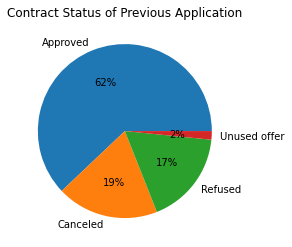

In [96]:
#Analysis on contract status of previous application data
plt.pie(prevappldata.NAME_CONTRACT_STATUS.value_counts(normalize=True)*100,labels=['Approved','Canceled', 
                                                                                   'Refused', 'Unused offer'], autopct='%1.f%%')
plt.title('Contract Status of Previous Application')
plt.show()

- We can see that majority of the loans are approved and very less percentage of loans are unused offer. 

In [101]:
#function to count plot for categorical variables
def count_plot(var):
    
    plt.style.use('ggplot')
    sns.despine
    fig,ax = plt.subplots(1,1,figsize=(15,5))
    
    sns.countplot(x=var, data=prevappldata, ax=ax, hue='NAME_CONTRACT_STATUS')
    ax.set_ylabel('Total Counts')
    ax.set_title(f'Distribution of {var}', fontsize=12)
    ax.set_xticklabels(ax.get_xticklabels(), rotation=45, ha="right")
    
    plt.show()

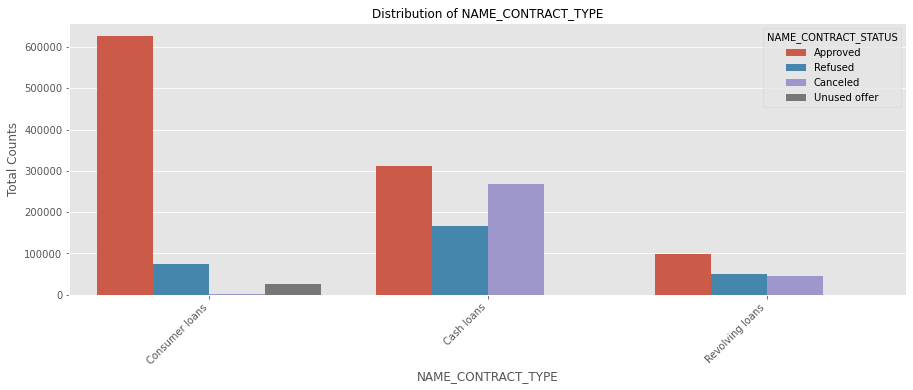

In [102]:
count_plot('NAME_CONTRACT_TYPE')

- From the above plot, we can conclude that most of the applications are for consumer loans and cash loans.
- Also, the cash loans are refused more often than others.

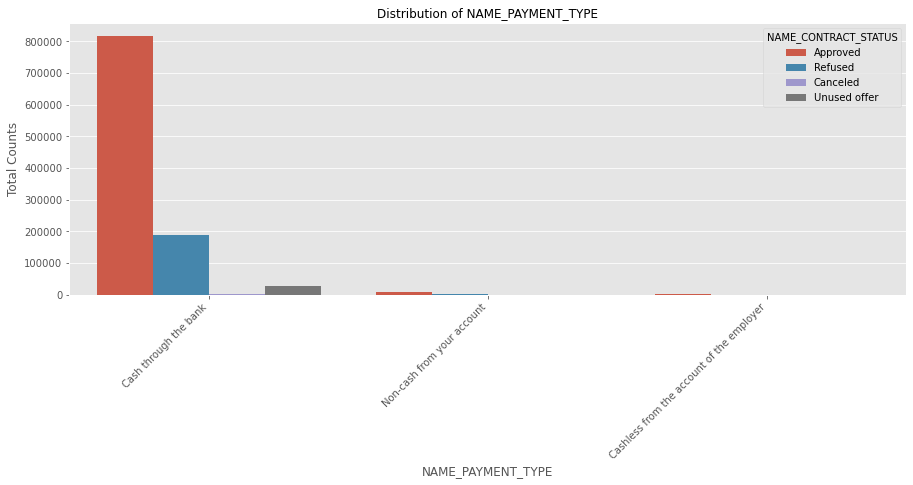

In [103]:
count_plot('NAME_PAYMENT_TYPE')

- We can observe that most of the clients prefer to repay the loan using the 'Cash through the bank' option.
- Also, 'Non-cash from your account' and 'Cashless from the acount of the employer' options are least preferred/not at all preferred for loan repayment.

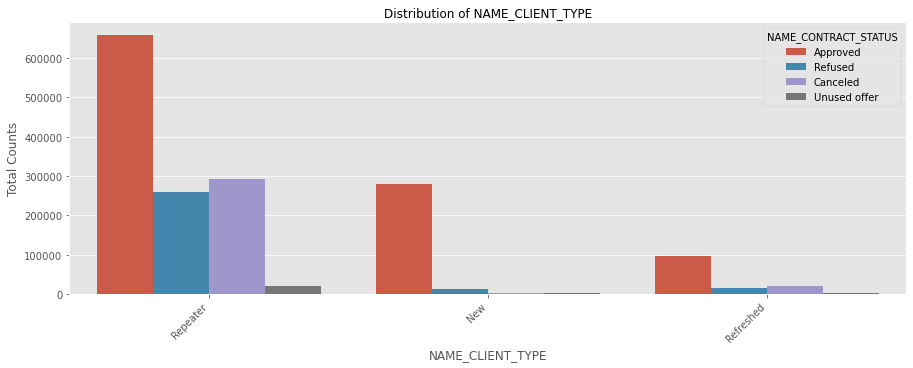

In [104]:
count_plot('NAME_CLIENT_TYPE')

- We can conclude that most of the applications are from repeaters or repeat customers.
- They also get refused most often.

17. Checking the correlation in the previous application dataset 

In [105]:
corr = prevappldata.corr()
corr=corr.where(np.triu(np.ones(corr.shape), k=1).astype(np.bool))
corr_dataf = corr.unstack().reset_index()

corr_dataf.columns = ['VAR1', 'VAR2', 'CORRELATION']
corr_dataf.dropna(subset=['CORRELATION'], inplace=True)
corr_dataf['CORR_ABS_VALUES'] = corr_dataf['CORRELATION'].abs()

corr_dataf.sort_values('CORR_ABS_VALUES', ascending=False).head(10)

,VAR1,VAR2,CORRELATION,CORR_ABS_VALUES
129,AMT_GOODS_PRICE,AMT_APPLICATION,0.999884,0.999884
130,AMT_GOODS_PRICE,AMT_CREDIT,0.993087,0.993087
87,AMT_CREDIT,AMT_APPLICATION,0.975824,0.975824
417,DAYS_TERMINATION,DAYS_LAST_DUE,0.927777,0.927777
128,AMT_GOODS_PRICE,AMT_ANNUITY,0.820895,0.820895
86,AMT_CREDIT,AMT_ANNUITY,0.816429,0.816429
65,AMT_APPLICATION,AMT_ANNUITY,0.808872,0.808872
372,DAYS_LAST_DUE_1ST_VERSION,DAYS_FIRST_DRAWING,-0.803504,0.803504
297,CNT_PAYMENT,AMT_APPLICATION,0.680630,0.680630
298,CNT_PAYMENT,AMT_CREDIT,0.674278,0.674278


18. Bivariate analysis after combining previous and current data

In [113]:
new_app_merge = pd.merge(left=newappldata, right=prevappldata, how='inner', on='SK_ID_CURR',suffixes='_x')

In [114]:
#Renaming the column names after merging
new_app_merge1 = new_app_merge.rename({'NAME_CONTRACT_TYPE_' : 'NAME_CONTRACT_TYPE','AMT_CREDIT_':'AMT_CREDIT','AMT_ANNUITY_':'AMT_ANNUITY',
                         'WEEKDAY_APPR_PROCESS_START_' : 'WEEKDAY_APPR_PROCESS_START',
                         'HOUR_APPR_PROCESS_START_':'HOUR_APPR_PROCESS_START','NAME_CONTRACT_TYPEx':'NAME_CONTRACT_TYPE_PREV',
                         'AMT_CREDITx':'AMT_CREDIT_PREV','AMT_ANNUITYx':'AMT_ANNUITY_PREV',
                         'WEEKDAY_APPR_PROCESS_STARTx':'WEEKDAY_APPR_PROCESS_START_PREV',
                         'HOUR_APPR_PROCESS_STARTx':'HOUR_APPR_PROCESS_START_PREV'}, axis=1)

In [115]:
# Removing unwanted columns for analysis

new_app_merge1.drop(['SK_ID_CURR','WEEKDAY_APPR_PROCESS_START', 'HOUR_APPR_PROCESS_START','REG_REGION_NOT_LIVE_REGION', 
              'REG_REGION_NOT_WORK_REGION','LIVE_REGION_NOT_WORK_REGION', 'REG_CITY_NOT_LIVE_CITY',
              'REG_CITY_NOT_WORK_CITY', 'LIVE_CITY_NOT_WORK_CITY','WEEKDAY_APPR_PROCESS_START_PREV',
              'HOUR_APPR_PROCESS_START_PREV', 'FLAG_LAST_APPL_PER_CONTRACT','NFLAG_LAST_APPL_IN_DAY'],axis=1,inplace=True)

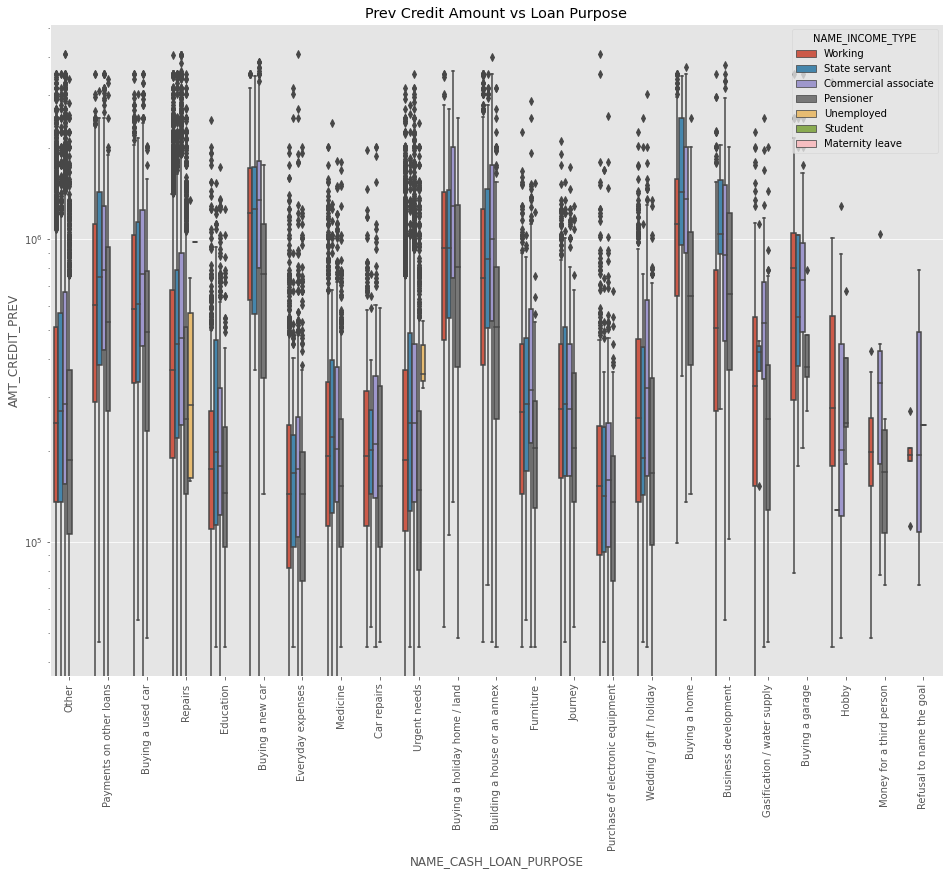

In [120]:
# Box plotting for credit amount 
plt.figure(figsize=(16,12))
plt.xticks(rotation=90)
plt.yscale('log')
sns.boxplot(data=new_app_merge1, x='NAME_CASH_LOAN_PURPOSE', hue='NAME_INCOME_TYPE', y='AMT_CREDIT_PREV', orient='v')
plt.title('Prev Credit Amount vs Loan Purpose')
plt.show()

- The credit amount of Loan purposes like 'Buying a home', 'Buying a land', 'Buying a new car' and 'Building a house' is higher.
- Income type of state servants have a significant amount of credit applied.
- 'Money for a third person' or a 'Hobby' is having less credits applied.

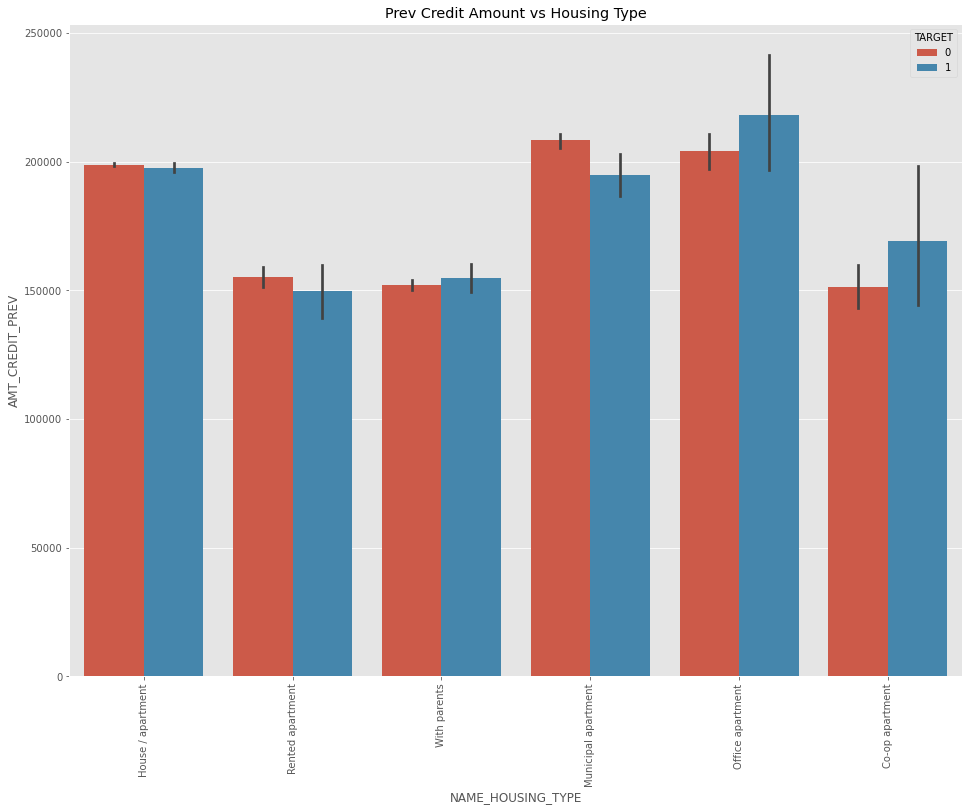

In [126]:
# Plotting for credit amount prev v/s housing type 

plt.figure(figsize=(16,12))
plt.xticks(rotation=90)
sns.barplot(data=new_app_merge1, y='AMT_CREDIT_PREV', hue='TARGET',x='NAME_HOUSING_TYPE', orient='v')
plt.title('Prev Credit Amount vs Housing Type')
plt.show()

- Here for Housing Type, office apartment is having maximum credit of target 1 and Municipal apartment is having higher credit of target 0. 
- So, we can conclude that bank should avoid giving loans to housing type of office apartment as they are having difficulties in loan payment.
- Banks can focus mostly on parents or House/apartment or Municipal apartment for successfull payments.

In [127]:
table= pd.pivot_table(new_app_merge, values='TARGET', index=['NAME_CLIENT_TYPE'], columns=['NAME_CONTRACT_STATUS'], aggfunc=np.mean)

In [128]:
table

NAME_CONTRACT_STATUS,Approved,Canceled,Refused,Unused offer
NAME_CLIENT_TYPE,,,,
New,0.088216,0.145205,0.110940,0.089448
Refreshed,0.065158,0.081098,0.117412,0.074324
Repeater,0.072144,0.091767,0.120596,0.083338


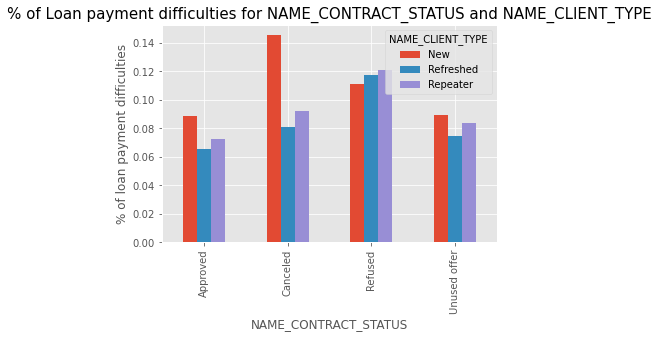

In [131]:
exp = table.T.plot(kind='bar')
ylab = exp.set_ylabel('% of loan payment difficulties')
plt.title('% of Loan payment difficulties for NAME_CONTRACT_STATUS and NAME_CLIENT_TYPE',fontdict={'fontsize' :15})
plt.show()

- It can be observed that the client who were 'New' and had 'Canceled' previous application tend to have more percentage of loan payment difficulties in current application.